## Decision Tree 

In [159]:
import pandas as pd
raw_df = pd.read_csv("C:\\Users\\saifr\\OneDrive\\Documents\\IML Hands on\\weatherAUS.csv")

In [160]:
raw_df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


Each row shows the measurements for a given date at a given location. The last column "RainTomorrow" contains the value to be predicted.

Let's check the column types of the dataset.

In [161]:
raw_df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object



Let's drop any rows where the value of the target column `RainTomorrow` in empty.

In [162]:
raw_df.dropna(subset=['RainTomorrow'], inplace=True)

In [163]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [164]:
px.histogram(raw_df, x='Location', title='Location vs. Rainy Days', color='RainTomorrow')

In [165]:
px.histogram(raw_df, 
             x='Temp3pm', 
             title='Temperature at 3 pm vs. Rain Tomorrow', 
             color='RainTomorrow')

In [166]:
raw_df.dropna(subset=['RainToday', 'RainTomorrow'], inplace=True)

In [167]:
px.histogram(raw_df, 
             x='RainTomorrow', 
             color='RainToday', 
             title='Rain Tomorrow vs. Rain Today')

In [168]:
px.histogram(raw_df, x='Location', title='Location vs. Rainy Days', color='RainToday')

In [169]:
px.histogram(raw_df, 
             x='RainToday', 
             color='RainTomorrow', 
             title='Rain Tomorrow vs. Rain Today')

In [170]:
px.histogram(raw_df, 
             x='Temp3pm', 
             title='Temperature at 3 pm vs. Rain Tomorrow', 
             color='RainToday')

In [171]:
px.scatter(raw_df.sample(2000), 
           title='Min Temp. vs Max Temp.',
           x='MinTemp', 
           y='MaxTemp', 
           color='RainToday')

In [172]:
px.scatter(raw_df.sample(2000), 
           title='Temp (3 pm) vs. Humidity (3 pm)',
           x='Temp3pm',
           y='Humidity3pm',
           color='RainTomorrow')

## Training, Validation and Test Sets

Here, since there is date column, I'm spliting the data according to the year instead of randomly splitting it

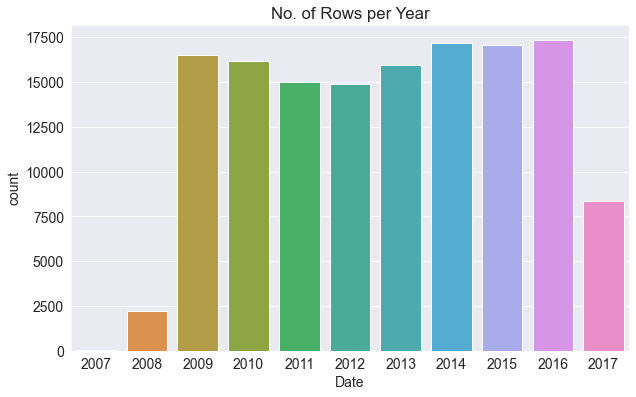

In [173]:
plt.title('No. of Rows per Year')
sns.countplot(x=pd.to_datetime(raw_df.Date).dt.year);

In [174]:
year = pd.to_datetime(raw_df.Date).dt.year

train_df = raw_df[year < 2015]
val_df = raw_df[year == 2015]
test_df = raw_df[year > 2015]

In [175]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (97988, 23)
val_df.shape : (17089, 23)
test_df.shape : (25710, 23)


Althought its not a perfect 60-20-20 split, I have ensured that the test validation and test sets both contain data for all 12 months of the year.

In [176]:
train_df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [177]:
val_df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
144913,2015-12-27,Uluru,20.5,34.7,0.0,NaN,NaN,E,52.0,ESE,...,23.0,12.0,1013.2,1010.1,NaN,NaN,24.3,33.0,No,No
144914,2015-12-28,Uluru,18.0,36.4,0.0,NaN,NaN,ESE,54.0,E,...,17.0,7.0,1014.7,1010.9,NaN,NaN,26.7,35.0,No,No
144915,2015-12-29,Uluru,17.5,37.1,0.0,NaN,NaN,E,56.0,E,...,12.0,7.0,1012.6,1007.5,NaN,NaN,28.1,34.7,No,No
144916,2015-12-30,Uluru,20.0,38.9,0.0,NaN,NaN,E,59.0,E,...,12.0,12.0,1007.2,1002.6,NaN,1.0,31.3,38.4,No,No
144917,2015-12-31,Uluru,19.3,37.4,0.0,NaN,NaN,SE,56.0,ESE,...,46.0,18.0,1007.3,1003.7,NaN,NaN,25.8,35.8,No,No


In [178]:
test_df.sample(20)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
5647,2016-05-20,BadgerysCreek,5.9,24.0,0.0,NaN,NaN,WSW,31.0,E,...,69.0,37.0,1020.8,1018.7,NaN,NaN,15.5,23.4,No,No
143656,2016-11-12,Katherine,27.0,40.7,0.0,8.0,NaN,N,30.0,WNW,...,58.0,NaN,1011.3,1006.1,3.0,NaN,32.2,NaN,No,No
132894,2017-02-09,Hobart,16.6,24.6,0.0,6.8,5.7,SW,61.0,SW,...,73.0,56.0,1003.9,1008.9,7.0,7.0,20.5,20.2,No,No
99395,2017-02-28,Adelaide,21.7,38.4,0.0,NaN,NaN,ESE,35.0,NE,...,22.0,18.0,1017.7,1015.7,NaN,NaN,30.0,36.8,No,No
36284,2016-10-24,SydneyAirport,9.9,18.7,0.6,5.8,12.4,S,37.0,SW,...,44.0,45.0,1019.5,1016.6,1.0,1.0,15.1,17.8,No,No
114347,2016-09-26,Witchcliffe,7.4,17.4,0.2,NaN,NaN,W,52.0,WNW,...,74.0,73.0,1017.4,1016.1,NaN,NaN,14.1,15.2,No,Yes
102329,2016-11-14,MountGambier,9.9,16.0,5.6,NaN,NaN,SSW,41.0,SW,...,96.0,76.0,1015.7,1017.5,7.0,8.0,12.7,14.5,Yes,No
111445,2017-01-11,Albany,17.5,23.1,0.0,NaN,NaN,NaN,NaN,NW,...,80.0,NaN,1009.0,1002.5,5.0,NaN,20.2,NaN,No,No
117344,2016-09-14,PearceRAAF,7.3,18.9,0.0,NaN,11.0,E,39.0,E,...,59.0,39.0,1027.0,1022.5,NaN,NaN,13.0,18.1,No,No
108298,2016-09-26,Woomera,6.6,26.5,0.0,5.6,NaN,W,56.0,N,...,24.0,16.0,1014.8,1011.2,2.0,NaN,18.1,25.6,No,No


### Input and Target Columns

In [179]:
input_cols = list(train_df.columns)[1:-1]
target_col = 'RainTomorrow'

In [180]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

In [181]:
val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_col].copy()

In [182]:
test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [183]:
import numpy as np

numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [184]:
print(numeric_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [185]:
print(categorical_cols)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']


### Imputing missing numeric values

In [186]:
from sklearn.impute import SimpleImputer

In [187]:
imputer = SimpleImputer(strategy = 'median').fit(raw_df[numeric_cols])

In [188]:
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [189]:
test_inputs[numeric_cols].isna().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
dtype: int64

### Scaling Numeric Features

In [190]:
from sklearn.preprocessing import MinMaxScaler

In [191]:
scaler = MinMaxScaler().fit(raw_df[numeric_cols])

In [192]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [193]:
val_inputs.describe().loc[['min', 'max']]

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
min,0.007075,0.030246,0.000000,0.000000,0.0,0.007752,0.000000,0.000000,0.04,0.0,0.125620,0.0816,0.000000,0.000000,0.021097,0.026871
max,0.952830,0.948960,0.666307,0.485517,1.0,1.000000,0.669231,0.850575,1.00,1.0,0.971901,0.9632,0.888889,0.888889,0.943038,0.925144


### Encoding Categorical Data

In [194]:
from sklearn.preprocessing import OneHotEncoder

In [195]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore').fit(raw_df[categorical_cols])

In [196]:
encoded_cols = list(encoder.get_feature_names(categorical_cols))

C:\Users\saifr\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [197]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

C:\Users\saifr\AppData\Local\Temp\ipykernel_3076\1584174743.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\saifr\AppData\Local\Temp\ipykernel_3076\1584174743.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\saifr\AppData\Local\Temp\ipykernel_3076\1584174743.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented fra

In [198]:
test_inputs

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_nan,RainToday_No,RainToday_Yes
2498,Albury,0.681604,0.801512,0.000000,0.033103,0.586207,ENE,0.372093,NaN,ESE,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2499,Albury,0.693396,0.725898,0.001078,0.033103,0.586207,SSE,0.341085,SSE,SE,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2500,Albury,0.634434,0.527410,0.005930,0.033103,0.586207,ENE,0.325581,ESE,ENE,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2501,Albury,0.608491,0.538752,0.042049,0.033103,0.586207,SSE,0.255814,SE,SSE,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2502,Albury,0.566038,0.523629,0.018329,0.033103,0.586207,ENE,0.193798,SE,SSE,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,Uluru,0.283019,0.502836,0.000000,0.033103,0.586207,E,0.193798,ESE,E,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145455,Uluru,0.266509,0.533081,0.000000,0.033103,0.586207,E,0.193798,SE,ENE,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145456,Uluru,0.285377,0.568998,0.000000,0.033103,0.586207,NNW,0.124031,SE,N,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145457,Uluru,0.327830,0.599244,0.000000,0.033103,0.586207,N,0.240310,SE,WNW,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [199]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [200]:
X_test

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,WindDir3pm_nan,RainToday_No,RainToday_Yes
2498,0.681604,0.801512,0.000000,0.033103,0.586207,0.372093,0.000000,0.080460,0.46,0.17,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2499,0.693396,0.725898,0.001078,0.033103,0.586207,0.341085,0.069231,0.195402,0.54,0.30,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2500,0.634434,0.527410,0.005930,0.033103,0.586207,0.325581,0.084615,0.448276,0.62,0.67,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2501,0.608491,0.538752,0.042049,0.033103,0.586207,0.255814,0.069231,0.195402,0.74,0.65,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2502,0.566038,0.523629,0.018329,0.033103,0.586207,0.193798,0.046154,0.103448,0.92,0.63,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,0.283019,0.502836,0.000000,0.033103,0.586207,0.193798,0.115385,0.149425,0.59,0.27,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145455,0.266509,0.533081,0.000000,0.033103,0.586207,0.193798,0.100000,0.126437,0.51,0.24,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145456,0.285377,0.568998,0.000000,0.033103,0.586207,0.124031,0.100000,0.103448,0.56,0.21,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
145457,0.327830,0.599244,0.000000,0.033103,0.586207,0.240310,0.069231,0.103448,0.53,0.24,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


### Training

I'm using the `DecisionTreeClassifier` from `sklearn.tree` to train a decision tree.

In [201]:
from sklearn.tree import DecisionTreeClassifier

In [202]:
model = DecisionTreeClassifier()

In [203]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 5.59 s
Wall time: 5.67 s


DecisionTreeClassifier()

An optimal decision tree has now been created using the training data.

### Evaluation

Let's evaluate the decision tree using the accuracy score.

In [204]:
from sklearn.metrics import accuracy_score, confusion_matrix

In [205]:
train_preds = model.predict(X_train)

In [206]:
train_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [207]:
pd.value_counts(train_preds)

No     76192
Yes    21796
dtype: int64

In [208]:
pd.value_counts(train_targets)

No     76190
Yes    21798
Name: RainTomorrow, dtype: int64

In [218]:
val_preds = model.predict(X_val)

In [219]:
val_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [220]:
pd.value_counts(test_preds)

No     19612
Yes     6098
dtype: int64

In [221]:
pd.value_counts(val_targets)

No     13511
Yes     3578
Name: RainTomorrow, dtype: int64

In [209]:
test_preds = model.predict(X_test)

In [210]:
test_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [211]:
pd.value_counts(test_preds)

No     19612
Yes     6098
dtype: int64

In [212]:
pd.value_counts(test_targets)

No     19885
Yes     5825
Name: RainTomorrow, dtype: int64

Seems like the decision tree is quite confident about its predictions.

Let's check the accuracy of its predictions.

In [213]:
accuracy_score(train_targets, train_preds)

0.9999795893374699

In [222]:
accuracy_score(val_targets, val_preds)

0.793492890163263

In [216]:
accuracy_score(test_preds, test_targets)

0.7748346946713341

This means our model has resulted into 'overfitting'

### Visualization

We can visualize the decision tree _learned_ from the training data.

In [63]:
from sklearn.tree import plot_tree, export_text

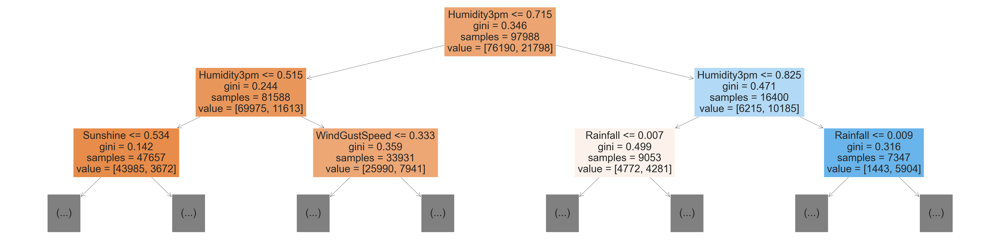

In [64]:
plt.figure(figsize=(80,20))
plot_tree(model, feature_names=X_train.columns, max_depth=2, filled=True);

In [65]:
model.tree_.max_depth

42

### Feature Importance

In [66]:
model.feature_importances_

array([3.80743498e-02, 3.32173826e-02, 4.42880197e-02, 2.29700500e-02,
       4.72751869e-02, 5.97370198e-02, 2.73987058e-02, 2.82204254e-02,
       3.64610433e-02, 2.75310280e-01, 3.65578241e-02, 6.13967378e-02,
       1.37284314e-02, 1.76527820e-02, 3.67087750e-02, 3.09482376e-02,
       2.03946513e-03, 1.89912094e-03, 1.17604345e-03, 7.41798883e-04,
       2.07647830e-03, 1.36375120e-03, 1.43759945e-03, 1.79309719e-03,
       7.89969271e-04, 1.44136936e-03, 8.34387256e-04, 1.86932773e-03,
       1.69025044e-03, 5.72047121e-04, 7.32723393e-04, 1.48489345e-03,
       1.38215012e-04, 1.51335635e-03, 8.92652183e-04, 1.21569366e-03,
       9.59501248e-04, 7.39711079e-04, 1.28963041e-03, 1.66269480e-03,
       2.77251059e-04, 7.82414620e-04, 1.37624229e-03, 1.64106146e-03,
       1.43896848e-03, 1.04656196e-03, 5.67501339e-04, 1.54502848e-03,
       1.34457078e-03, 2.18987985e-03, 8.47740441e-04, 1.90104983e-03,
       1.19840494e-03, 2.24800108e-03, 7.24853120e-04, 4.16869368e-04,
      

Let's turn this into a dataframe and visualize the most important features.

In [67]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model.feature_importances_
}).sort_values('importance', ascending=False)

In [68]:
importance_df.head(10)

,feature,importance
9,Humidity3pm,0.275310
11,Pressure3pm,0.061397
5,WindGustSpeed,0.059737
4,Sunshine,0.047275
2,Rainfall,0.044288
0,MinTemp,0.038074
14,Temp9am,0.036709
10,Pressure9am,0.036558
8,Humidity9am,0.036461
1,MaxTemp,0.033217


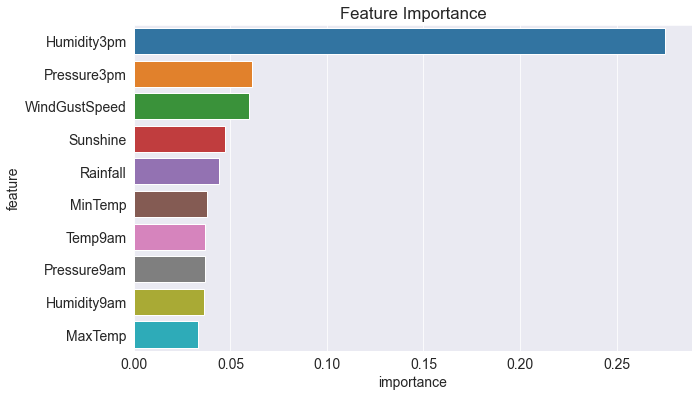

In [69]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

### `max_depth`

By reducing the maximum depth of the decision tree, we can prevent the tree from memorizing all training examples, which may lead to better generalization

In [223]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth=md, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    valid_acc = 1 - model.score(X_val, val_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Validation Error': valid_acc, 'Difference': abs(valid_acc - train_acc)}

In [224]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: total: 1min 6s
Wall time: 1min 6s


In [225]:
errors_df

,Max Depth,Training Error,Validation Error,Difference
0,1,0.181941,0.176488,0.005453
1,2,0.176930,0.170695,0.006235
2,3,0.168408,0.165194,0.003214
3,4,0.162153,0.161624,0.000528
4,5,0.157213,0.158230,0.001017
5,6,0.153162,0.155539,0.002377
6,7,0.149294,0.155071,0.005777
7,8,0.144854,0.154251,0.009397
8,9,0.140007,0.154895,0.014888
9,10,0.132557,0.154544,0.021987


By observing the above values for 'Validation Error', we can see that for Max_depth = 9, the Validation Error is the minimum.
Hence, we will be applying the 'max_depth = 9' hyperparameter and verify the accuracy score 

In [230]:
model = DecisionTreeClassifier(max_depth=9)

In [231]:
model.fit(X_train, train_targets)

DecisionTreeClassifier(max_depth=9)

In [235]:
train_preds = model.predict(X_train)

In [236]:
train_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [237]:
pd.value_counts(train_preds)

No     83245
Yes    14743
dtype: int64

In [238]:
val_preds = model.predict(X_val)

In [239]:
val_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [242]:
pd.value_counts(val_preds)

No     14923
Yes     2166
dtype: int64

In [243]:
pd.value_counts(val_targets)

No     13511
Yes     3578
Name: RainTomorrow, dtype: int64

In [244]:
test_preds = model.predict(X_test)

In [245]:
test_preds

array(['No', 'No', 'No', ..., 'No', 'No', 'No'], dtype=object)

In [246]:
pd.value_counts(test_preds)

No     21995
Yes     3715
dtype: int64

In [247]:
pd.value_counts(test_targets)

No     19885
Yes     5825
Name: RainTomorrow, dtype: int64

In [248]:
accuracy_score(train_targets, train_preds)

0.8599930603747398

In [249]:
accuracy_score(val_targets, val_preds)

0.8450465211539587

In [250]:
accuracy_score(test_preds, test_targets)

0.8318164138467522

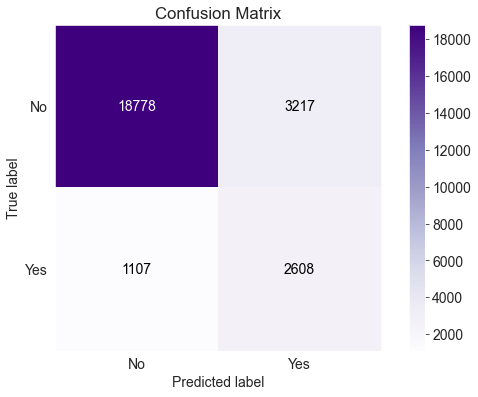

In [261]:
import scikitplot as skplt

skplt.metrics.plot_confusion_matrix(test_preds, test_targets,
                                    title="Confusion Matrix",
                                    cmap="Purples",
                                    );

In [262]:
raw_df['RainTomorrow'].value_counts()

No     109586
Yes     31201
Name: RainTomorrow, dtype: int64

Here we can see that there are a lot more records for the Class 'No' than 'Yes', which results into our model performing very well in classifying the 'No' Classes but performing extremely poor classifying the 'Yes' ones, in fact misclassifying the majority of them

# Random Forest 

In [263]:
from sklearn.ensemble import RandomForestClassifier

In [264]:
model = RandomForestClassifier(n_jobs=-1, random_state=42)

In [265]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 1min 25s
Wall time: 15.7 s


RandomForestClassifier(n_jobs=-1, random_state=42)

In [266]:
model.score(X_train, train_targets)

0.9999693840062048

In [267]:
model.score(X_val, val_targets)

0.8588565744045877

In [268]:
model.score(X_test, test_targets)

0.8469856087125632

In [269]:
def max_depth_error2(md):
    model = RandomForestClassifier(n_jobs=-1, random_state=42, max_depth=md)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    valid_acc = 1 - model.score(X_val, val_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Validation Error': valid_acc, 'Difference': abs(valid_acc - train_acc)}

In [274]:
%%time
errors_df = pd.DataFrame([max_depth_error2(md) for md in range(1, 30)])

CPU times: total: 27min 58s
Wall time: 4min 11s


In [275]:
errors_df

,Max Depth,Training Error,Validation Error,Difference
0,1,0.222456,0.209374,0.013081
1,2,0.222435,0.209374,0.013061
2,3,0.203209,0.196618,0.006591
3,4,0.189880,0.184622,0.005259
4,5,0.178348,0.173737,0.004611
5,6,0.168572,0.166832,0.001739
6,7,0.161326,0.160981,0.000345
7,8,0.156560,0.159225,0.002665
8,9,0.150569,0.157119,0.006549
9,10,0.143497,0.153666,0.010169


By observing the above values for 'Validation Error', we can see that for Max_depth = 22, the Validation Error is the minimum, but the difference between the Validation Error & Training Error is the lowest for Max_depth = 7.
Hence, we will be applying the 'max_depth = 7' hyperparameter and verify the accuracy score 

In [281]:
model = RandomForestClassifier(n_jobs=-1, random_state=42, max_depth = 7)

In [282]:
%%time
model.fit(X_train, train_targets)

CPU times: total: 31.8 s
Wall time: 4.73 s


RandomForestClassifier(max_depth=7, n_jobs=-1, random_state=42)

In [283]:
model.score(X_train, train_targets)

0.8386741233620443

In [284]:
accuracy_score(val_targets, val_preds)

0.8450465211539587

In [285]:
accuracy_score(test_preds, test_targets)

0.8318164138467522